<a href="https://colab.research.google.com/github/AdityaASD1/Music-Generation/blob/main/MusicGene.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Importing all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
# Downloading the dataset
songs = mdl.lab1.load_training_data()


Found 817 songs in text


In [ ]:

# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs)

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


In [ ]:
type(vocab)

list

In [ ]:
char2idx = {x:i for i,x in enumerate(vocab)}
idx2char = np.array(vocab)

In [ ]:
# Converts word to numbers
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [ ]:
def get_batch(vectorized_songs, seq_length, batch_size):
  n = vectorized_songs.shape[0] - 1
  # retrun array of batch_size where idx[i] is between (0,n-seq_length)
  # Below line is same as np.random.randint(0,n-seq_length,batch_size) where n-seq_length is not included
  idx = np.random.choice(n-seq_length, batch_size)
  input_batch = [vectorized_songs[i:i+seq_length] for i in idx]
  output_batch = [vectorized_songs[i+1:i+1+seq_length] for i in idx]
  x_batch = np.reshape(input_batch,[batch_size,seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch

In [ ]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units,
      return_sequences=True,
      recurrent_initializer='glorot_uniform',
      recurrent_activation='sigmoid',
      stateful=True,
  )


In [ ]:

def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
    LSTM(rnn_units),
    tf.keras.layers.Dense(vocab_size)

  ])
  return model

model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [ ]:
model.summary()

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_28 (Embedding)    (32, None, 256)           21248     
                                                                 
 lstm_28 (LSTM)              (32, None, 1024)          5246976   
                                                                 
 dense_28 (Dense)            (32, None, 83)            85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [ ]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)

In [ ]:
# Why does we have use sparse_categorical_crossentropy ?
# Since the musical notation are limited i.e around 70 and they have descrete class so we used the above fucntion
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss
example_batch_loss = compute_loss(y, pred)

In [ ]:
num_training_iterations = 2000
batch_size = 4
seq_length = 100
learning_rate = 5e-3

vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024

In [ ]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)
optimizer = tf.keras.optimizers.Adam(learning_rate)

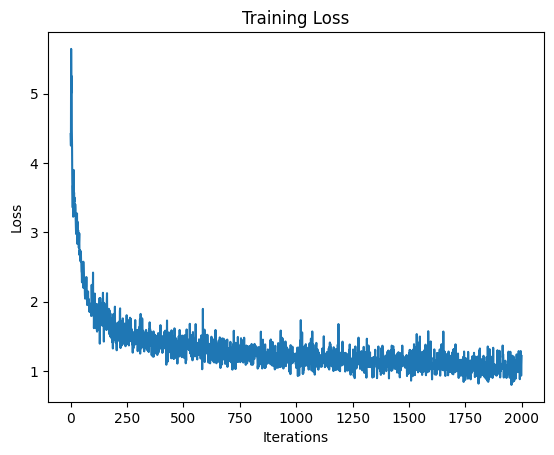

In [ ]:
def train_step(x, y):
  with tf.GradientTape() as tape:
    y_hat = model(x)
    loss = compute_loss(y, y_hat)
  grads = tape.gradient(loss, model.trainable_variables)
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss
import matplotlib.pyplot as plt


history = []
for iter in range(num_training_iterations):
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)
  history.append(loss.numpy().mean())

plt.plot(range(num_training_iterations), history)
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.show()

In [ ]:
#vectorized_songs = [49 22 13 ... 22 82  2]
# x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
#x_batch
# [[22 13 11 20  0 36 22 32  1 38 56 65 70 73  0 30 82 29 32 26  1 27 15 82
#   58 27 26  1 27 15 82 29 32 26  1 27 26 32 82 31 15  1 26 31 29 82  2  0
#   29 32 26  1 27 15 82 58 27 26  1 27 14 58 82 59 60 59  1 58 26 31 82 26
#   32 31  1 32 14 22 82  2  0 58 82 27 26 32  1 26 31 29 82 29 15 26 31 29
#   82 29 15  1]
#  [59 27  1 26 58 27 26 22 82  2  0 32 14 62 14  1 60 59 60 62 82 27 15 26
#    1 27 58 27 26 82 32 14 62 14  1 60 59 60 62 82 56 15 62  1 56 58  5 57
#   56 82  2  0 62 14 61 62  1 60 59 60 62 82 27 58 27 26  1 27 14 59 14 82
#   60 61 60 59  1 27 59 60 61 82 62 60 59 27  1 26 58 27 26 22 82  2  0  0
#   49 22 14 15]
#  [22 26  1 29 70 73 64 56 69  0 26 14 27 26  1 27 59 60 61 82 62 60 59 27
#    1 26 32 30 31 82 32 14 27 32  1 59 32 27 32 82 29 30 32 26  1 27 26 59
#   27 82  2  0 26 14 27 26  1 27 59 60 61 82 62 60 59 27  1 26 32 30 32 82
#   27 15 32  1 26 14 32 30 82 29 30 32 26  1 27 26 26 14 22 82  2  0 60 56
#   56 62  1 56]
#  [ 0 32 26 32 31  1 32 26 27 14 82 26 27 26 32  1 26 27 58 14 82 27 26 32
#   31  1 30 31 32 26 82 31 14 30 29  1 29 16 82  2  0 58 59 60 61  1 61 62
#   62 56 82 56 57 57 58  5  1 56 14 62 61 82 62 56 61 56  1 61 14 60 59 82
#   58 14 60 14  1 61 16 22 82  2  0  0 49 22 14  0 45 22 27 73 64 56 69  1
#   38 56 62 76]]
# y_batch
# [[13 11 20  0 36 22 32  1 38 56 65 70 73  0 30 82 29 32 26  1 27 15 82 58
#   27 26  1 27 15 82 29 32 26  1 27 26 32 82 31 15  1 26 31 29 82  2  0 29
#   32 26  1 27 15 82 58 27 26  1 27 14 58 82 59 60 59  1 58 26 31 82 26 32
#   31  1 32 14 22 82  2  0 58 82 27 26 32  1 26 31 29 82 29 15 26 31 29 82
#   29 15  1 26]
#  [27  1 26 58 27 26 22 82  2  0 32 14 62 14  1 60 59 60 62 82 27 15 26  1
#   27 58 27 26 82 32 14 62 14  1 60 59 60 62 82 56 15 62  1 56 58  5 57 56
#   82  2  0 62 14 61 62  1 60 59 60 62 82 27 58 27 26  1 27 14 59 14 82 60
#   61 60 59  1 27 59 60 61 82 62 60 59 27  1 26 58 27 26 22 82  2  0  0 49
#   22 14 15 21]
#  [26  1 29 70 73 64 56 69  0 26 14 27 26  1 27 59 60 61 82 62 60 59 27  1
#   26 32 30 31 82 32 14 27 32  1 59 32 27 32 82 29 30 32 26  1 27 26 59 27
#   82  2  0 26 14 27 26  1 27 59 60 61 82 62 60 59 27  1 26 32 30 32 82 27
#   15 32  1 26 14 32 30 82 29 30 32 26  1 27 26 26 14 22 82  2  0 60 56 56
#   62  1 56 14]
#  [32 26 32 31  1 32 26 27 14 82 26 27 26 32  1 26 27 58 14 82 27 26 32 31
#    1 30 31 32 26 82 31 14 30 29  1 29 16 82  2  0 58 59 60 61  1 61 62 62
#   56 82 56 57 57 58  5  1 56 14 62 61 82 62 56 61 56  1 61 14 60 59 82 58
#   14 60 14  1 61 16 22 82  2  0  0 49 22 14  0 45 22 27 73 64 56 69  1 38
#   56 62 76 64]]

# loss = train_step(x_batch, y_batch)
# print(len(loss)) = 4
# print(loss)
# tf.Tensor(
# [[3.14511871e+00 7.88383007e-01 1.58289361e+00 3.25832963e+00
#   5.39077707e-02 3.82468142e-02 1.75236128e-05 9.04323876e-01
#   6.75501581e-03 6.59367593e-04 3.35540104e+00 4.61203516e-01
#   5.19450055e-03 7.96286331e-05 2.83745432e+00 1.90708721e+00
#   2.91794133e+00 4.16706991e+00 6.26436055e-01 1.53315449e+00
#   2.58030027e-01 5.92102098e+00 8.92647028e-01 6.94034278e-01
#   1.74294412e+00 6.37984276e-01 3.24818420e+00 1.43450904e+00
#   1.75256193e+00 2.99385738e+00 1.78853440e+00 2.39945102e+00
#   2.06255317e+00 1.54608740e-02 1.98463778e-04 2.14073248e-03
#   8.01986549e-03 8.75923783e-04 3.13398382e-03 9.94607247e-03
#   1.98596087e-03 9.11416369e-04 3.71593142e+00 2.12171599e-02
#   4.57356311e-02 1.25998640e-02 8.95476341e-02 6.62185699e-02
#   1.41813010e-01 3.15540582e-02 7.82264397e-02 7.65302926e-02
#   6.64904341e-02 4.71768826e-02 1.02637568e-02 4.50061727e-03
#   3.50680637e+00 6.49284199e-02 1.24496175e-03 3.64710600e-03
#   7.20593631e-01 6.31267726e-01 1.51971681e-03 3.35160352e-04
#   3.39123118e-03 2.65086332e-04 4.89711063e-04 3.50175571e-04
#   5.30102407e-04 9.53628842e-05 1.79867697e+00 4.19403566e-03
#   3.40428263e-01 3.64525691e-02 1.71359500e-03 1.99619238e-03
#   2.37207185e-03 5.59194107e-03 1.76858064e-02 8.81032467e-01
#   6.99968636e-01 3.90915006e-01 1.14729023e+00 1.07098651e+00
#   7.56187737e-01 3.53363194e-02 1.12661886e+00 7.72071183e-01
#   9.00440156e-01 4.69814837e-01 4.56113927e-03 9.28776488e-02
#   1.48749924e+00 9.81923938e-01 4.27128851e-01 1.44604100e-02
#   1.08006239e+00 3.00379062e+00 1.32999396e+00 1.02298804e-01]
#  [1.09658899e+01 1.08670273e+01 4.54396904e-01 8.94944131e-01
#   3.78153592e-01 2.69904280e+00 3.90048139e-02 7.09671557e-01
#   8.84031892e-01 9.66890063e-03 1.22252607e+00 2.19144583e+00
#   6.55933544e-02 1.54113460e+00 2.00849152e+00 4.75789964e-01
#   1.99850295e-02 9.73593473e-01 1.04365742e+00 4.23203520e-02
#   2.84870243e+00 1.35215747e+00 8.57633576e-02 2.43743658e-01
#   6.62165046e-01 5.57829857e-01 1.98899079e-02 5.50476194e-04
#   6.00796775e-05 8.81765723e-01 6.42247451e-03 1.24269968e-03
#   3.37545490e+00 4.60863948e-01 4.18691291e-03 1.33624679e-04
#   2.60229588e+00 1.81457007e+00 3.26876187e+00 7.80368388e-01
#   4.21198273e+00 4.42519188e-01 1.23832607e+00 7.52974212e-01
#   1.31519723e+00 2.09741783e+00 3.57671404e+00 2.40770912e+00
#   3.53446960e-01 1.26605678e+00 1.68391800e+00 1.33956652e-02
#   1.05087354e-03 2.57437778e+00 8.49640846e-01 5.71633697e-01
#   7.25536644e-02 1.76996017e+00 1.00106068e-01 1.82583046e+00
#   8.11062217e-01 9.74147022e-01 1.11386704e-03 6.27797446e-04
#   2.36350903e-03 3.25316936e-03 6.82478654e-04 3.08906264e-03
#   8.85996502e-03 1.74881995e-03 8.37690372e-04 2.62523413e+00
#   1.35415075e-02 1.41193736e-02 3.57441278e-03 5.59739396e-03
#   4.41588042e-03 4.92257404e+00 1.06910825e+00 3.18246777e-03
#   1.89767906e-03 7.97225475e-01 3.10653215e-03 1.70812081e-03
#   1.88732753e-03 1.25643127e-02 3.60304752e-04 6.98043685e-03
#   3.81277816e-04 5.26647142e-04 6.52696239e-04 8.98315222e-04
#   1.28141779e-04 5.27807522e+00 3.57738361e-02 3.21972221e-02
#   2.59687677e-02 2.03664182e-03 4.52177803e-04 9.51314345e-04]
#  [3.52787924e+00 7.01614320e-01 2.78002167e+00 4.43107748e+00
#   1.68029058e+00 2.23624897e+00 2.09722424e+00 3.01844090e-01
#   6.63012445e-01 1.40079117e+00 7.45539427e-01 3.96607369e-01
#   3.11076427e+00 2.59812021e+00 1.55473813e-01 1.40990758e+00
#   1.17221288e-03 1.56962764e+00 1.23482704e+00 3.11656833e-01
#   9.52272862e-03 3.18220377e+00 1.14216924e+00 1.26611674e+00
#   4.80377972e-02 3.21810031e+00 1.71525800e+00 2.63502669e+00
#   1.79125257e-02 6.38037622e-01 4.05513239e+00 1.30876616e-01
#   1.46794403e+00 2.67583370e+00 6.35774374e-01 5.68546820e-03
#   5.54802477e-01 9.79161263e-01 1.75393552e-01 8.29930529e-02
#   8.15402567e-01 9.51619148e-01 1.29538822e+00 5.75856417e-02
#   3.90514165e-01 2.80936384e+00 1.38438260e-02 3.98627063e-03
#   4.80401904e-05 5.36764979e-01 4.12173802e-03 7.57645583e-04
#   3.37741399e+00 3.39918911e-01 4.31107683e-03 1.23135615e-04
#   2.57225251e+00 1.33901370e+00 2.42115751e-01 5.07142358e-02
#   2.05005575e-02 7.20512748e-01 2.99754715e+00 3.45340371e+00
#   1.52778900e+00 2.02423167e+00 2.37155986e+00 2.65255898e-01
#   4.21564048e-03 1.00130790e-04 2.10278528e-03 5.21383109e-03
#   6.52577088e-04 2.77657923e-03 7.38876499e-03 1.69288786e-03
#   8.06959637e-04 2.89094281e+00 1.26079679e-03 2.33175489e-03
#   7.26533728e-03 2.31346321e+00 1.67447567e+00 4.32911888e-03
#   1.94075005e-03 3.46206069e-01 8.70564021e-04 2.14953488e-03
#   1.27758400e-03 4.89711063e-04 1.41372220e-04 3.63190263e-03
#   8.08206314e-05 2.97263789e-04 5.73470665e-04 3.96173185e-04
#   1.00965168e-04 8.31765711e-01 1.91074228e-04 2.05686446e-02]
#  [9.06344128e+00 4.98150378e-01 8.61101866e-01 1.70245185e-01
#   1.16937474e-04 1.68872264e-03 5.49034309e-03 6.65919739e-04
#   3.01704207e-03 5.31379692e-03 1.99036277e-03 8.52102472e-04
#   2.89418721e+00 1.35651568e-03 2.61263200e-03 6.89614704e-03
#   3.86648154e+00 2.23024797e+00 2.63783801e-03 1.26258261e-03
#   2.65257299e-01 3.13709636e-04 1.63040694e-03 1.46662875e-03
#   4.16907191e-04 1.65329620e-04 3.78938857e-03 6.92581962e-05
#   2.88206531e-04 5.81691333e-04 3.97841446e-04 9.98923933e-05
#   8.31566334e-01 1.92266103e-04 2.03246549e-02 3.49700594e+00
#   3.33900824e-02 2.46043061e-03 4.44994215e-03 3.98306502e-03
#   1.88851729e-03 2.57482170e-03 2.97461171e-03 3.71280834e-02
#   9.99308890e-04 3.29539776e+00 2.94466376e+00 2.65611935e+00
#   5.17595768e-01 2.78926015e+00 1.69454694e+00 3.20532298e+00
#   6.38682395e-02 2.15848863e-01 1.09177256e+00 1.22927594e+00
#   3.75827355e-03 6.52953148e-01 1.19482386e+00 3.99090916e-01
#   2.67146558e-01 4.53976917e+00 8.31110418e-01 8.57832730e-01
#   6.51758211e-03 3.04355454e+00 1.53330708e+00 3.69976950e+00
#   6.25301525e-02 3.16137701e-01 1.15327036e+00 8.68468344e-01
#   5.25806379e-03 3.10908604e+00 2.27926254e+00 2.07951117e+00
#   2.59446073e-02 4.43012774e-01 6.01110980e-04 7.93351293e-01
#   1.98666739e+00 1.28161716e+00 6.73737330e-03 2.70955276e+00
#   1.70151997e+00 3.45492911e+00 4.90249917e-02 2.30077460e-01
#   1.20284319e+00 9.65152383e-01 3.86254117e-03 7.24629998e-01
#   1.24150872e+00 1.93570566e+00 2.65891831e-02 4.98039603e-01
#   1.84933639e+00 1.12375998e+00 2.76741870e-02 1.65165401e+00]], shape=(4, 100), dtype=float32)
# history.append(loss.numpy().mean())
# loss.numpy().mean()

In [ ]:
model1 = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)
model1.set_weights(model.get_weights())
model1.summary()

Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_30 (Embedding)    (1, None, 256)            21248     
                                                                 
 lstm_30 (LSTM)              (1, None, 1024)           5246976   
                                                                 
 dense_30 (Dense)            (1, None, 83)             85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [229]:
def generate_text(model, start_string, generation_length=1000):
  input_eval = [char2idx[s] for s in start_string]
  input_eval = tf.expand_dims(input_eval, 0)
  text_generated = []
  model.reset_states()
  tqdm._instances.clear()
  for i in tqdm(range(generation_length)):
      predictions = model1(input_eval)
      predictions = tf.squeeze(predictions, 0)
      predictions = tf.squeeze(predictions, 0)
      predicted_id = np.argmax(predictions)
      input_eval = tf.expand_dims([predicted_id], 0)
      text_generated.append(idx2char[predicted_id])
  return (start_string + ''.join(text_generated))

# def generate_text(model, start_string, generation_length=1000):
#   input_eval = [char2idx[s] for s in start_string]
#   input_eval = tf.expand_dims(input_eval, 0)
#   text_generated = []
#   model.reset_states()
#   tqdm._instances.clear()

#   for i in tqdm(range(generation_length)):
#       predictions = model1(input_eval)
#       predictions = tf.squeeze(predictions, 0)
#       predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
#       input_eval = tf.expand_dims([predicted_id], 0)
#       text_generated.append(idx2char[predicted_id])

#   return (start_string + ''.join(text_generated))


In [230]:
generated_text = generate_text(model, start_string="a", generation_length=1000)

100%|██████████| 1000/1000 [00:08<00:00, 111.19it/s]


In [ ]:
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
  waveform = mdl.lab1.play_song(song)
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)


Found 5 songs in text
Generated song 1


Generated song 2


Generated song 3
